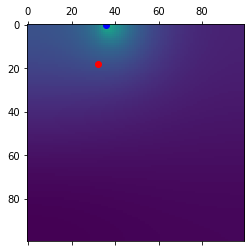

In [14]:
# Importing required libraries
import numpy as np                          # For numerical operations
import random                               # For random selections
import matplotlib.pyplot as plt             # For plotting
from matplotlib.animation import FuncAnimation # For creating animations
from IPython.display import clear_output, HTML # For displaying HTML output
import time                                 # For time operations (if needed)
from scipy.ndimage import gaussian_filter   # For applying a Gaussian filter

# Configuring matplotlib settings to allow large animations
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

# Defining a World class to represent the environment where agents interact
class World(object):
    
    def __init__(self, width, height, sigma):
        # Initialize the world with width, height, and Gaussian filter parameter sigma
        self.width, self.height = width, height
        self.sigma = sigma
        # Creating two agents at specified starting positions
        self.b = Agent(1, 1, self.width, self.height)
        self.m = Agent(self.width-2, self.height-2, self.width, self.height)
    
    def advance(self):
        # Apply Gaussian filter to smooth the chemical gradient (chemo) in the environment
        self.b.chemo = gaussian_filter(self.b.chemo, sigma=self.sigma)
        self.m.chemo = gaussian_filter(self.m.chemo, sigma=self.sigma)
        # Update chemo levels based on agents' positions to create attraction points
        self.b.chemo[self.m.y, self.m.x] += 1
        self.m.chemo[self.b.y, self.b.x] += 1
        # Advance each agent's position
        self.b.advance()
        self.m.advance()
        
    def plot(self, ax):
        # Plot the chemical gradient and agents' positions
        ax.matshow(self.m.chemo)   # Display the chemo gradient
        ax.plot([self.b.x], [self.b.y], 'bo') # Plot agent 'b' as a blue dot
        ax.plot([self.m.x], [self.m.y], 'ro') # Plot agent 'm' as a red dot

# Defining the Agent class to represent each agent within the world
class Agent(object):
    
    def __init__(self, x0, y0, width, height):
        # Initialize the agent's position and the chemo grid
        self.x, self.y = x0, y0
        self.width, self.height = width, height
        self.chemo = np.zeros((self.height, self.width))  # Chemical concentration grid
    
    def move(self):
        # Decide the movement direction based on neighboring chemo values
        directions = []
        weights = []
        # Check and add possible moves and weights for each direction
        if self.x != 0:
            directions.append('left')
            weights.append(self.chemo[self.y, self.x-1])
        if self.y != 0:
            directions.append('down')
            weights.append(self.chemo[self.y-1, self.x])
        if self.x != self.width - 1:
            directions.append('right')
            weights.append(self.chemo[self.y, self.x+1])
        if self.y != self.height - 1:
            directions.append('up')
            weights.append(self.chemo[self.y+1, self.x])
        
        # Add a small constant to weights to avoid zero probabilities
        weights = .01 + np.array(weights)
        # Select a movement direction based on weighted probabilities
        direction = random.choices(directions, weights)[0]
        
        # Update agent's position based on chosen direction
        if direction == 'up':
            self.y += 1
        elif direction == 'down':
            self.y -= 1
        elif direction == 'left':
            self.x -= 1
        elif direction == 'right':
            self.x += 1
    
    def advance(self):
        # Move the agent by updating its position
        self.move()

# Create an instance of the World class with specified dimensions and Gaussian filter sigma
g = World(100, 100, 1)

# Set up the plot for animation
fig, ax = plt.subplots()

def init():
    # Initialize the plot settings
    ax.clear()
    ax.set_xlim(0, g.width)
    ax.set_ylim(0, g.height)
    return []

def update(frame):
    # Update function called for each frame in the animation
    for i in range(3): # Advance the world state a few times for each frame
        g.advance()
    ax.clear()   # Clear the previous frame
    g.plot(ax)   # Plot the new state
    return []

# Create the animation object
anim = FuncAnimation(fig, update, frames=3000, init_func=init, blit=False, interval=10)

# Display the animation in HTML format (for Jupyter Notebook or similar environments)
HTML(anim.to_jshtml())

In [7]:
# class World(object):
    
#     def __init__(self, width, height, sigma):
#         self.width, self.height = width, height
#         self.sigma = sigma
#         self.b = Agent(1, 1, self.width, self.height)
#         self.m = Agent(self.width-2,self.height-2, self.width, self.height)
    
#     def advance(self):
#         self.b.chemo = gaussian_filter(self.b.chemo, sigma=self.sigma)
#         self.m.chemo = gaussian_filter(self.m.chemo, sigma=self.sigma)
#         self.b.chemo[self.m.y, self.m.x] += 1
#         self.m.chemo[self.b.y, self.b.x] += 1
#         self.b.advance()
#         self.m.advance()
        
#     def plot(self, ax):
#         ax.matshow(self.m.chemo)
#         ax.plot([self.b.x],[self.b.y], 'bo')
#         ax.plot([self.m.x],[self.m.y], 'ro')

In [8]:
# class Agent(object):
    
#     def __init__(self, x0, y0, width, height):
#         self.x, self.y = x0, y0
#         self.width, self.height = width, height
#         self.chemo = np.zeros((self.height, self.width))
    
#     def move(self):
#         directions = []
#         weights = []
#         if self.x != 0:
#             directions.append('left')
#             weights.append(self.chemo[self.y, self.x-1])
#         if self.y != 0:
#             directions.append('down')
#             weights.append(self.chemo[self.y-1, self.x])
#         if self.x != self.width - 1:
#             directions.append('right')
#             weights.append(self.chemo[self.y, self.x+1])
#         if self.y != self.height - 1:
#             directions.append('up')
#             weights.append(self.chemo[self.y+1, self.x])
        
#         weights = .01 + np.array(weights)
#         direction = random.choices(directions, weights)[0]
        
#         if direction == 'up':
#             self.y += 1
#         elif direction == 'down':
#             self.y -= 1
#         elif direction == 'left':
#             self.x -= 1
#         elif direction == 'right':
#             self.x += 1
    
#     def advance(self):
#         self.move()

In [9]:
# g = World(100, 100, 1)

In [10]:
# fig, ax = plt.subplots()
# def init():
#     # Clear the axis
#     ax.clear()
#     # Set up initial plot settings (e.g., labels, limits)
#     ax.set_xlim(0, g.width)
#     ax.set_ylim(0, g.height)
#     # Initialize your plot here (if needed)
#     return []

# def update(frame):
#     for i in range(3):
#         g.advance()
#     ax.clear()   # Clear the previous frame
#     g.plot(ax)  # Advance your object
#     # Plot your data from g here, e.g.:
#     # ax.plot(g.x_data, g.y_data)
#     # You can also update titles, labels, etc.
#     return []

# # Create an animation
# anim = FuncAnimation(fig, update, frames=3000, init_func=init, blit=False, interval=10)

# # Show the animation
# HTML(anim.to_jshtml())

In [11]:
# EQUAL PROBABILITY

# class Agent(object):
    
#     def __init__(self, x0, y0, width, height):
#         self.x, self.y = x0, y0
#         self.width, self.height = width, height
#         pass
    
#     def move(self, chemo):
#         directions = []
#         if self.x != 0:
#             directions.append('left')
#         if self.y != 0:
#             directions.append('down')
#         if self.x != self.width - 1:
#             directions.append('right')
#         if self.y != self.height - 1:
#             directions.append('up')

#         direction = random.choice(directions)
        
#         if direction == 'up':
#             self.y += 1
#         elif direction == 'down':
#             self.y -= 1
#         elif direction == 'left':
#             self.x -= 1
#         elif direction == 'right':
#             self.x += 1
    
#     def advance(self, world):
#         self.move(world.chemo)
#         world.chemo[self.y, self.x] += 1